In [1]:
!pip install torcheval

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.2/179.2 kB 3.7 MB/s eta 0:00:00a 0:00:01


In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from torcheval.metrics.functional import peak_signal_noise_ratio
from PIL import Image
import os
import numpy as np
import matplotlib.pyplot as plt

In [3]:
seed = 42
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)

In [10]:
!gdown '1bsWkNmmYvBrgE1c58SGJFcCjQv3SUyH3'

Downloading...
From (original): https://drive.google.com/uc?id=1bsWkNmmYvBrgE1c58SGJFcCjQv3SUyH3
From (redirected): https://drive.google.com/uc?id=1bsWkNmmYvBrgE1c58SGJFcCjQv3SUyH3&confirm=t&uuid=18f3754a-d248-4bec-aa68-f1bf20f6bc8a
To: /kaggle/working/Khoa_LHR_image.zip
100%|██████████████████████████████████████| 89.0M/89.0M [00:01<00:00, 58.9MB/s]


In [23]:
!unzip -q '/kaggle/working/Khoa_LHR_image.zip' -d '/kaggle/working/'

In [24]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [25]:
class First_Feature(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(First_Feature, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.LeakyReLU()
        )

    def forward(self, x):
        return self.conv(x)

class Conv_Block(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Conv_Block, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(inplace=True)
        )

    def forward(self, x):
        return self.conv(x)

class Encoder(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Encoder, self).__init__()
        self.encode = nn.Sequential(
            nn.MaxPool2d(2),
            Conv_Block(in_channels, out_channels)
        )

    def forward(self, x):
        return self.encode(x)

class Decoder(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Decoder, self).__init__()
        self.decode = nn.Sequential(
            nn.UpsamplingBilinear2d(scale_factor=2),
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(inplace=True)
        )
        self.conv = Conv_Block(in_channels, out_channels)

    def forward(self, x, skip):
        x = self.decode(x)
        x = torch.concat([x, skip], dim=1)
        x = self.conv(x)

        return x

class Final_Output(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Final_Output, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        return self.conv(x)

class Unet(nn.Module):
    def __init__(self, n_channels=3, n_classes=3):
        super(Unet, self).__init__()
        self.conv_1 = First_Feature(n_channels, 64)
        self.conv_2 = Conv_Block(64, 64)

        self.encode_1 = Encoder(64, 128)
        self.encode_2 = Encoder(128, 256)
        self.encode_3 = Encoder(256, 512)
        self.encode_4 = Encoder(512, 1024)

        self.decode_1 = Decoder(1024, 512)
        self.decode_2 = Decoder(512, 256)
        self.decode_3 = Decoder(256, 128)
        self.decode_4 = Decoder(128, 64)

        self.out_conv = Final_Output(64, 3)

    def forward(self, x):
        x = self.conv_1(x)
        x1 = self.conv_2(x)

        x2 = self.encode_1(x1)
        x3 = self.encode_2(x2)
        x4 = self.encode_3(x3)
        x5 = self.encode_4(x4)

        x = self.decode_1(x5, x4)
        x = self.decode_2(x, x3)
        x = self.decode_3(x, x2)
        x = self.decode_4(x, x1)

        x = self.out_conv(x)

        return x

In [26]:
train_path = 'Khoa_LHR_image/train/'
val_path = 'Khoa_LHR_image/val/'
batch_size = 8
learning_rate = 1e-4
epochs = 65

In [36]:
import cv2

In [46]:
class ImageSet(Dataset):
    def __init__(self, img_dir, is_train=True):
        super(ImageSet, self).__init__()
        self.img_dir = img_dir
        self.is_train = is_train
        self.images = os.listdir(img_dir)
    
    def __len__(self):
        return len(self.images)
    
    def normalize(self, input_image, target_image):
        input_image = (input_image * 2 - 1)
        target_image = (target_image * 2 - 1)
    
        return input_image, target_image
    
    def random_jitter(self, input_image, target_image):
        if torch.rand([]) < 0.5:
          input_image = transforms.functional.hflip(input_image)
          target_image = transforms.functional.hflip(target_image)
        
        return input_image, target_image

    def create_masked(self, image):
        masked_image = image.copy()
        mask = np.full((256, 256, 3), 0, np.uint8)
        for _ in range(np.random.randint(1, 5)):
            x1, x2 = np.random.randint(1, 256), np.random.randint(1, 256)
            y1, y2 = np.random.randint(1, 256), np.random.randint(1, 256)

            thickness = np.random.randint(1, 15)

            cv2.line(mask, (x1, y1), (x2, y2), (1, 1, 1), thickness)
            
        masked_image = np.where(mask, 255*np.ones_like(mask), masked_image)

        return masked_image
    
    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.images[idx])
        image = np.array(Image.open(img_path).convert('RGB'))

        input_image = self.create_masked(image)
        input_image = transforms.functional.to_tensor(input_image)
        target_image = transforms.functional.to_tensor(image)
        
        input_image = input_image.type(torch.float32)
        target_image = target_image.type(torch.float32)
        
        input_image, target_image = self.normalize(input_image, target_image)
        if self.is_train:
          input_image, target_image = self.random_jitter(input_image, target_image)
        
        return input_image, target_image

In [47]:
train_dataset = ImageSet(train_path, is_train=True)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataset = ImageSet(val_path, is_train=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

Text(0.5, 1.0, 'Target')

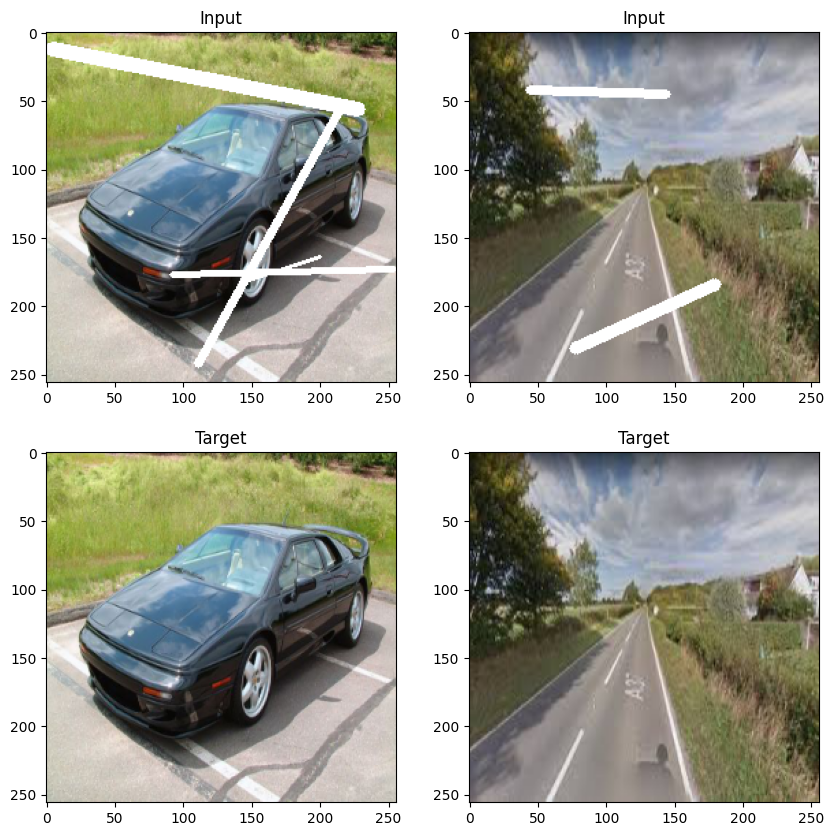

In [48]:
in_batch, tar_batch = next(iter(train_loader))
in_batch = (in_batch + 1)/2
tar_batch = (tar_batch + 1)/2

plt.figure(figsize=(10, 10))
ax = plt.subplot(2, 2, 1)
plt.imshow(np.squeeze(in_batch[0].numpy().transpose((1, 2, 0))))
plt.title("Input")
ax = plt.subplot(2, 2, 3)
plt.imshow(np.squeeze(tar_batch[0].numpy().transpose((1, 2, 0))))
plt.title("Target")
ax = plt.subplot(2, 2, 2)
plt.imshow(np.squeeze(in_batch[1].numpy().transpose((1, 2, 0))))
plt.title("Input")
ax = plt.subplot(2, 2, 4)
plt.imshow(np.squeeze(tar_batch[1].numpy().transpose((1, 2, 0))))
plt.title("Target")

In [49]:
def generate_images(model, inputs, labels):
    model.eval()
    with torch.no_grad():
        inputs, labels = inputs.to(device), labels.to(device)
        predictions = model(inputs)
    inputs, labels, predictions = inputs.cpu().numpy(), labels.cpu().numpy(), predictions.cpu().numpy()
    plt.figure(figsize=(15,20))

    display_list = [inputs[-1].transpose((1, 2, 0)), labels[-1].transpose((1, 2, 0)), predictions[-1].transpose((1, 2, 0))]
    title = ['Input', 'Real', 'Predicted']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] + 1) / 2)
        plt.axis('off')
    plt.show()

In [50]:
import time

def train_epoch(model, optimizer, criterion, train_loader, device, epoch=0, log_interval=50):
  model.train()
  train_losses = []
  train_psnr, train_count = 0, 0
  start_time = time.time()
  for idx,  (inputs, labels) in enumerate(train_loader):
    inputs, labels = inputs.to(device), labels.to(device)

    predictions = model(inputs)
    loss = criterion(predictions, labels)
    train_losses.append(loss.item())

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    train_psnr += peak_signal_noise_ratio(predictions, labels)
    train_count += 1

    if idx % log_interval == 0 and idx > 0:
            elapsed = time.time() - start_time
            print(
                "| epoch {:3d} | {:5d}/{:5d} batches "
                "| psnr {:8.3f}".format(
                    epoch, idx, len(train_loader), train_psnr / train_count
                )
            )
            train_psnr, train_count = 0, 0
            start_time = time.time()

  loss = sum(train_losses) / len(train_losses)
  psnr = train_psnr/ train_count

  return loss, psnr

In [51]:
def evaluate(model, criterion, test_loader, device):
  model.eval()
  test_losses = []
  test_psnr, test_count = 0, 0
  start_time = time.time()
  with torch.no_grad():
    for idx, (inputs, labels) in enumerate(test_loader):
      inputs, labels = inputs.to(device), labels.to(device)

      predictions = model(inputs)
      loss = criterion(predictions, labels)
      test_losses.append(loss.item())

      test_psnr += peak_signal_noise_ratio(predictions, labels)
      test_count += 1

    loss = sum(test_losses) / len(test_losses)
    psnr = test_psnr / test_count

    return loss, psnr

In [52]:
def train(model, model_name, save_model, optimizer, criterion, train_loader, test_loader, device, num_epochs):
  train_losses, train_psnrs = [], []
  test_losses, test_psnrs = [], []
  best_eval = -1000
  times = []
  for epoch in range(1, num_epochs + 1):
    epoch_start_time = time.time()

    train_loss, train_psnr = train_epoch(model, optimizer, criterion, train_loader, device, epoch)
    train_losses.append(train_loss)
    train_psnrs.append(train_psnr.cpu())

    test_loss, test_psnr = evaluate(model, criterion, test_loader, device)
    test_losses.append(test_loss)
    test_psnrs.append(test_psnr.cpu())

    if best_eval < test_psnr:
      best_eval = test_psnr
      torch.save(model.state_dict(), save_model + f'/{model_name}.pt')
      inputs_t, targets_t = next(iter(test_loader))
      generate_images(model, inputs_t, targets_t)
      best_psnr_eval = test_psnr
    times.append(time.time() - epoch_start_time)

    print("-" * 59)
    print(
        "| End of epoch {:3d} | Time: {:5.2f}s | Train psnr {:8.3f} | Train Loss {:8.3f} "
        "| Valid psnr {:8.3f} | Valid Loss {:8.3f} ".format(
            epoch, time.time() - epoch_start_time, train_psnr, train_loss, test_psnr, test_loss
        )
    )
    print("-" * 59)

    model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))
    model.eval()
    metrics = {
        'train_psnr': train_psnrs,
        'train_loss': train_losses,
        'valid_psnr': test_psnrs,
        'valid_loss': test_losses,
        'time': times
    }

  return model, metrics

In [53]:
import matplotlib.pyplot as plt

def plot_result(num_epochs, train_psnrs, eval_psnrs, train_losses, eval_losses):
    epochs = list(range(num_epochs))
    fig, axs = plt.subplots(nrows = 1, ncols =2 , figsize = (12,6))
    axs[0].plot(epochs, train_psnrs, label = "Training")
    axs[0].plot(epochs, eval_psnrs, label = "Evaluation")
    axs[1].plot(epochs, train_losses, label = "Training")
    axs[1].plot(epochs, eval_losses, label = "Evaluation")
    axs[0].set_xlabel("Epochs")
    axs[1].set_xlabel("Epochs")
    axs[0].set_ylabel("PSNR")
    axs[1].set_ylabel("Loss")
    plt.legend()

In [54]:
import matplotlib.pyplot as plt

def predict_and_display(model, test_dataloader, device):
    model.eval()

    with torch.no_grad():
        for idx, (inputs, labels) in enumerate(test_dataloader):
            if idx >= 10:
                break
            inputs = inputs.to(device)
            predictions = model(inputs)
            generate_images(model, inputs, labels)
            plt.show()

| epoch   1 |    50/   86 batches | psnr   16.582


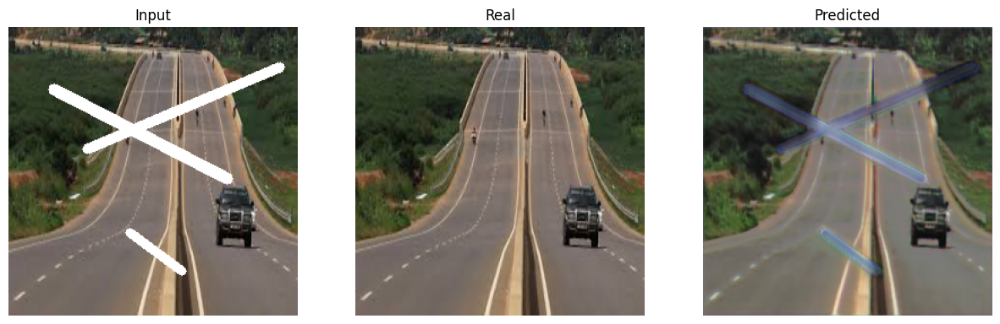

-----------------------------------------------------------
| End of epoch   1 | Time: 30.52s | Train psnr   19.977 | Train Loss    0.191 | Valid psnr   21.171 | Valid Loss    0.095 
-----------------------------------------------------------


<ipython-input-52-07fd8a1a5bbc>:34: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))


| epoch   2 |    50/   86 batches | psnr   21.268


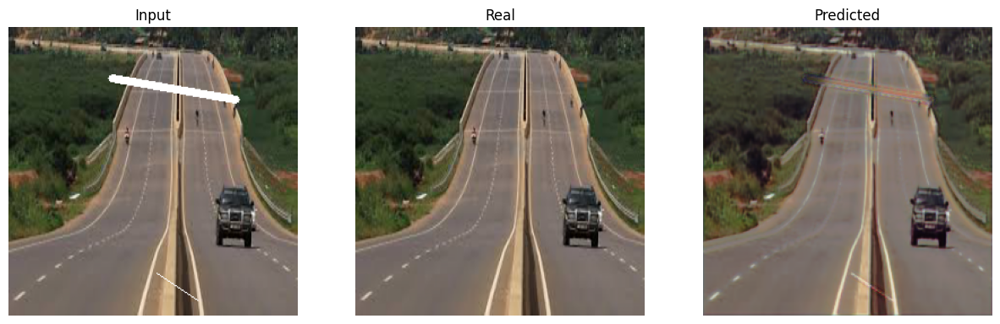

-----------------------------------------------------------
| End of epoch   2 | Time: 29.41s | Train psnr   22.611 | Train Loss    0.116 | Valid psnr   24.946 | Valid Loss    0.069 
-----------------------------------------------------------
| epoch   3 |    50/   86 batches | psnr   23.170


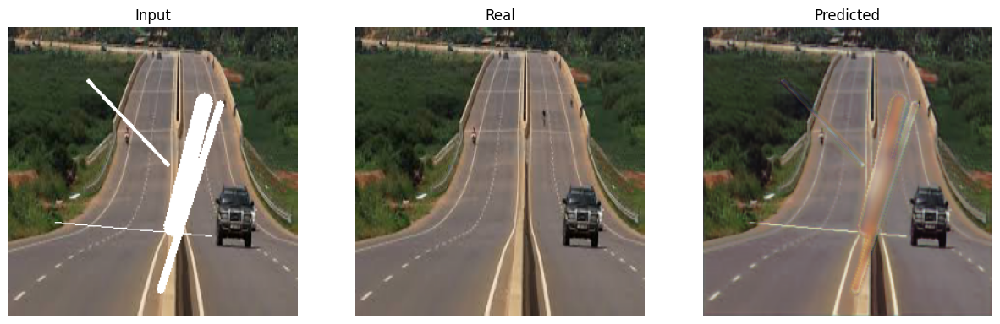

-----------------------------------------------------------
| End of epoch   3 | Time: 29.44s | Train psnr   23.904 | Train Loss    0.094 | Valid psnr   26.245 | Valid Loss    0.058 
-----------------------------------------------------------
| epoch   4 |    50/   86 batches | psnr   24.459
-----------------------------------------------------------
| End of epoch   4 | Time: 28.57s | Train psnr   24.408 | Train Loss    0.082 | Valid psnr   22.278 | Valid Loss    0.078 
-----------------------------------------------------------
| epoch   5 |    50/   86 batches | psnr   24.659
-----------------------------------------------------------
| End of epoch   5 | Time: 28.50s | Train psnr   24.499 | Train Loss    0.079 | Valid psnr   26.233 | Valid Loss    0.059 
-----------------------------------------------------------
| epoch   6 |    50/   86 batches | psnr   24.215
-----------------------------------------------------------
| End of epoch   6 | Time: 28.56s | Train psnr   24.365 | Tra

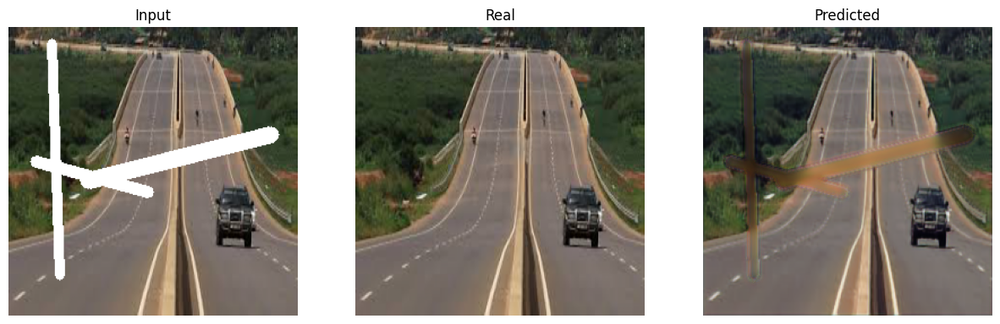

-----------------------------------------------------------
| End of epoch  28 | Time: 29.39s | Train psnr   24.451 | Train Loss    0.083 | Valid psnr   26.429 | Valid Loss    0.057 
-----------------------------------------------------------
| epoch  29 |    50/   86 batches | psnr   25.137
-----------------------------------------------------------
| End of epoch  29 | Time: 28.52s | Train psnr   25.364 | Train Loss    0.075 | Valid psnr   24.466 | Valid Loss    0.064 
-----------------------------------------------------------
| epoch  30 |    50/   86 batches | psnr   24.588
-----------------------------------------------------------
| End of epoch  30 | Time: 28.46s | Train psnr   25.284 | Train Loss    0.077 | Valid psnr   22.599 | Valid Loss    0.066 
-----------------------------------------------------------
| epoch  31 |    50/   86 batches | psnr   25.265
-----------------------------------------------------------
| End of epoch  31 | Time: 28.44s | Train psnr   25.118 | Tra

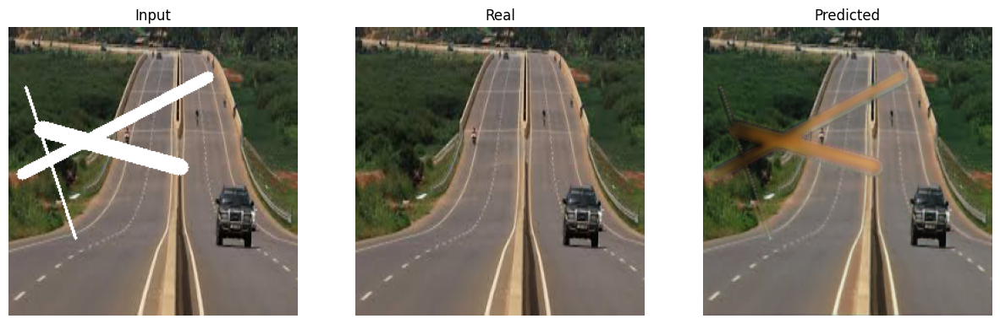

-----------------------------------------------------------
| End of epoch  37 | Time: 29.31s | Train psnr   24.901 | Train Loss    0.077 | Valid psnr   26.782 | Valid Loss    0.052 
-----------------------------------------------------------
| epoch  38 |    50/   86 batches | psnr   24.904
-----------------------------------------------------------
| End of epoch  38 | Time: 28.51s | Train psnr   25.622 | Train Loss    0.073 | Valid psnr   25.612 | Valid Loss    0.074 
-----------------------------------------------------------
| epoch  39 |    50/   86 batches | psnr   25.286
-----------------------------------------------------------
| End of epoch  39 | Time: 28.47s | Train psnr   25.558 | Train Loss    0.072 | Valid psnr    4.829 | Valid Loss    0.958 
-----------------------------------------------------------
| epoch  40 |    50/   86 batches | psnr   25.009


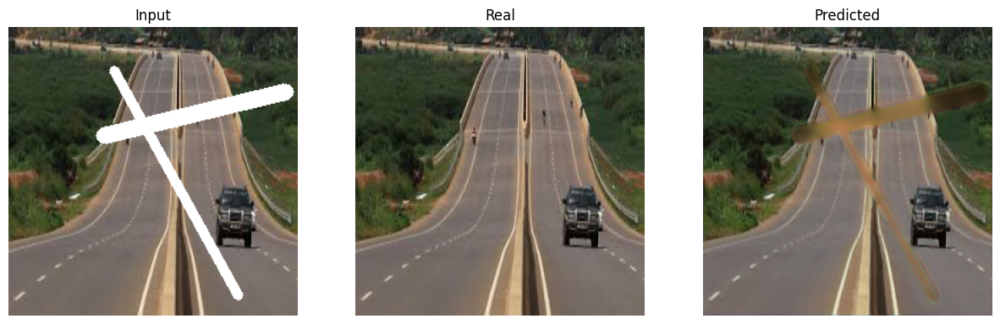

-----------------------------------------------------------
| End of epoch  40 | Time: 29.41s | Train psnr   25.245 | Train Loss    0.072 | Valid psnr   27.258 | Valid Loss    0.046 
-----------------------------------------------------------
| epoch  41 |    50/   86 batches | psnr   25.807
-----------------------------------------------------------
| End of epoch  41 | Time: 28.51s | Train psnr   25.801 | Train Loss    0.067 | Valid psnr   26.233 | Valid Loss    0.053 
-----------------------------------------------------------
| epoch  42 |    50/   86 batches | psnr   25.585
-----------------------------------------------------------
| End of epoch  42 | Time: 28.56s | Train psnr   25.863 | Train Loss    0.068 | Valid psnr   27.080 | Valid Loss    0.050 
-----------------------------------------------------------
| epoch  43 |    50/   86 batches | psnr   25.072
-----------------------------------------------------------
| End of epoch  43 | Time: 28.53s | Train psnr   26.041 | Tra

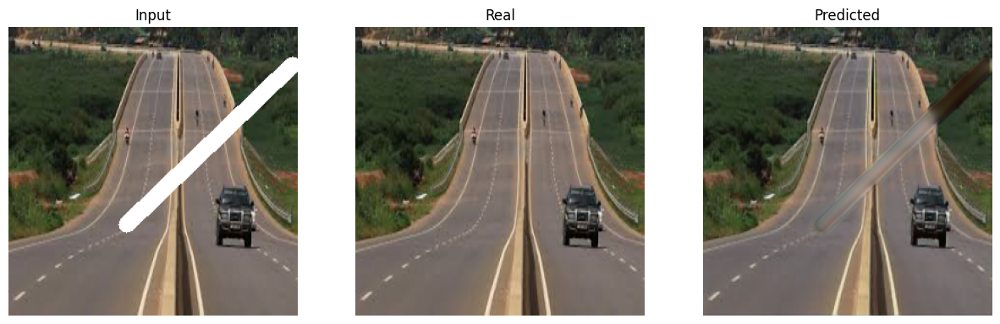

-----------------------------------------------------------
| End of epoch  45 | Time: 29.68s | Train psnr   25.646 | Train Loss    0.069 | Valid psnr   27.741 | Valid Loss    0.045 
-----------------------------------------------------------
| epoch  46 |    50/   86 batches | psnr   26.169


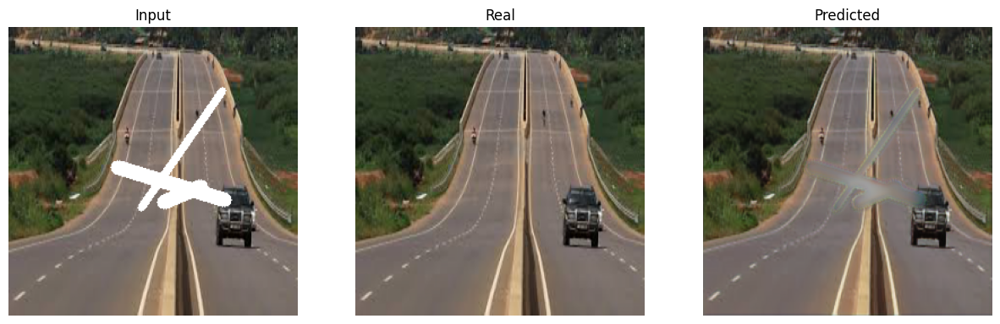

-----------------------------------------------------------
| End of epoch  46 | Time: 29.53s | Train psnr   25.846 | Train Loss    0.065 | Valid psnr   28.193 | Valid Loss    0.042 
-----------------------------------------------------------
| epoch  47 |    50/   86 batches | psnr   26.317
-----------------------------------------------------------
| End of epoch  47 | Time: 28.57s | Train psnr   26.534 | Train Loss    0.061 | Valid psnr   26.018 | Valid Loss    0.048 
-----------------------------------------------------------
| epoch  48 |    50/   86 batches | psnr   26.248
-----------------------------------------------------------
| End of epoch  48 | Time: 28.58s | Train psnr   26.401 | Train Loss    0.061 | Valid psnr   27.763 | Valid Loss    0.046 
-----------------------------------------------------------
| epoch  49 |    50/   86 batches | psnr   26.037
-----------------------------------------------------------
| End of epoch  49 | Time: 28.51s | Train psnr   24.718 | Tra

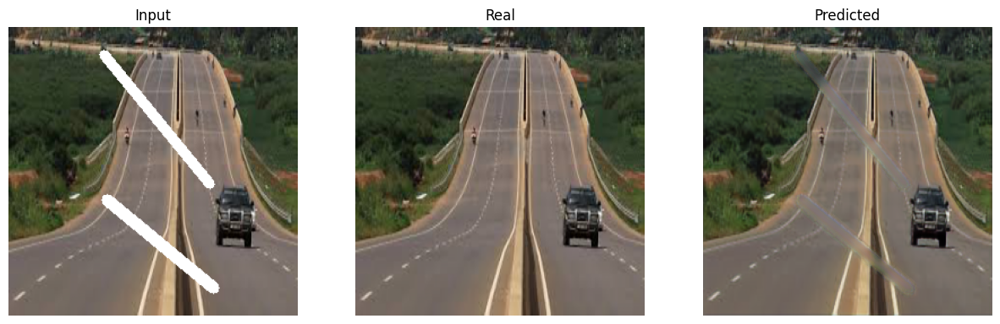

-----------------------------------------------------------
| End of epoch  54 | Time: 29.58s | Train psnr   26.645 | Train Loss    0.064 | Valid psnr   28.549 | Valid Loss    0.042 
-----------------------------------------------------------
| epoch  55 |    50/   86 batches | psnr   26.509
-----------------------------------------------------------
| End of epoch  55 | Time: 28.56s | Train psnr   26.387 | Train Loss    0.061 | Valid psnr   27.260 | Valid Loss    0.044 
-----------------------------------------------------------
| epoch  56 |    50/   86 batches | psnr   26.449
-----------------------------------------------------------
| End of epoch  56 | Time: 28.59s | Train psnr   26.387 | Train Loss    0.061 | Valid psnr   25.936 | Valid Loss    0.053 
-----------------------------------------------------------
| epoch  57 |    50/   86 batches | psnr   26.570
-----------------------------------------------------------
| End of epoch  57 | Time: 28.62s | Train psnr   26.424 | Tra

In [55]:
model = Unet()
model = model.to(device)

criterion = nn.L1Loss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate, betas=[0.5,0.999])
epochs = 65

save_model = './UNET'
os.makedirs(save_model, exist_ok = True)

model, metrics = train(model, 'UNET', save_model, optimizer, criterion, train_loader, test_loader, device, epochs)

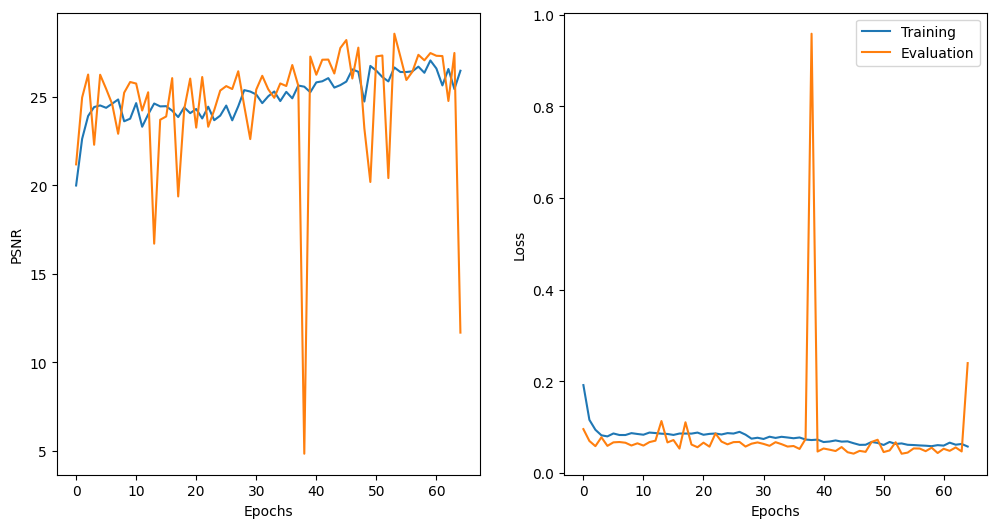

In [56]:
plot_result(
    epochs,
    metrics["train_psnr"],
    metrics["valid_psnr"],
    metrics["train_loss"],
    metrics["valid_loss"]
)

In [57]:
test_psnr, test_loss = evaluate(model, criterion, test_loader, device)
test_psnr, test_loss

(0.04283981914208694, tensor(28.2568, device='cuda:0'))

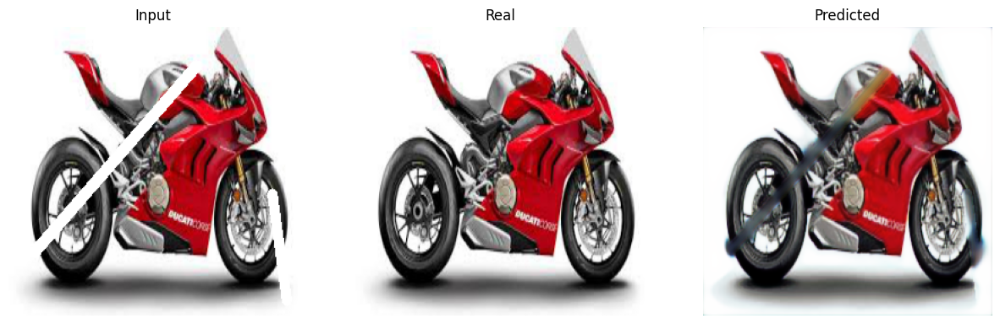

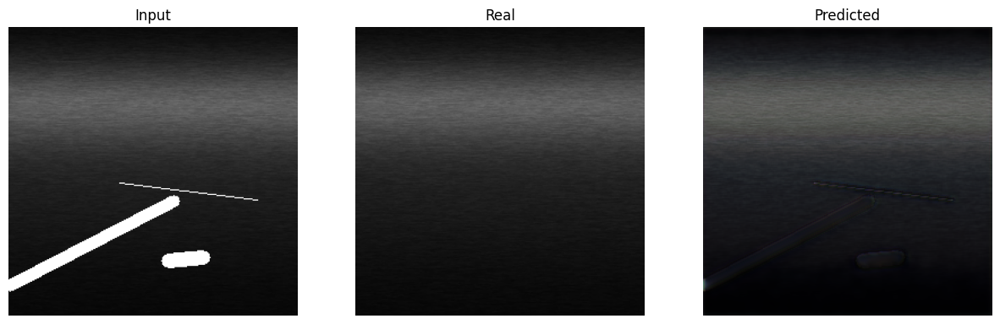

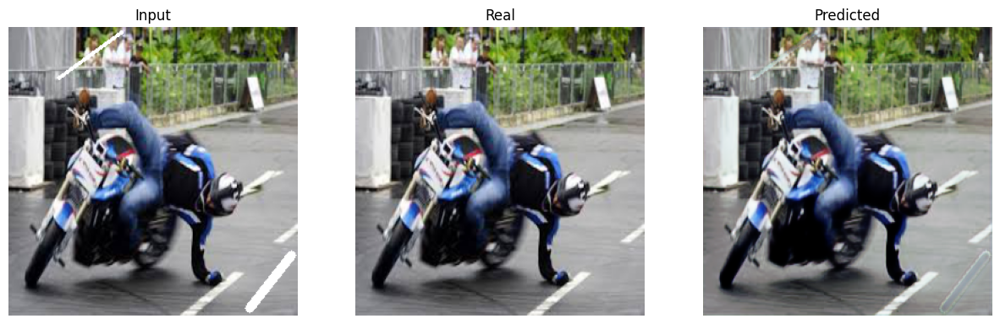

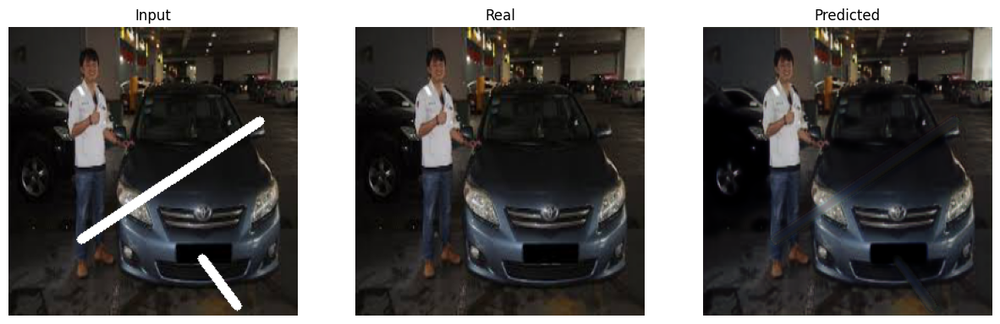

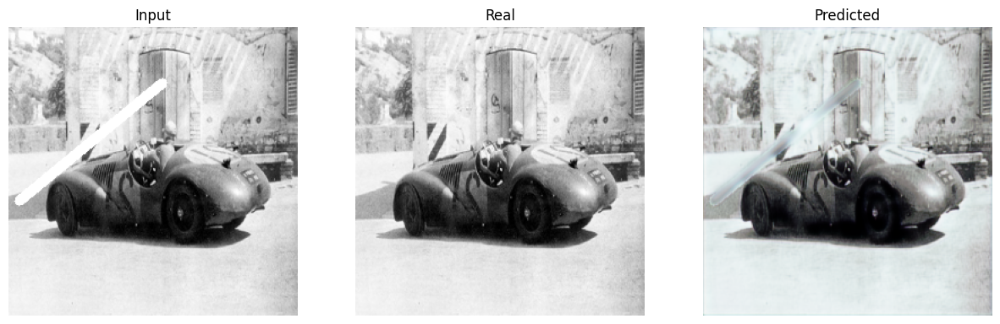

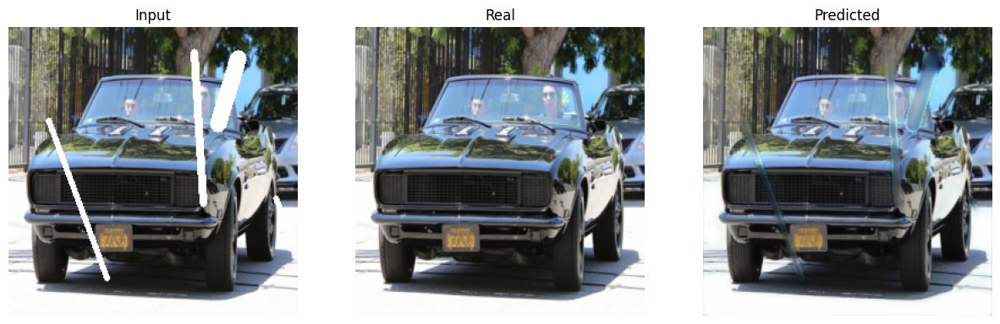

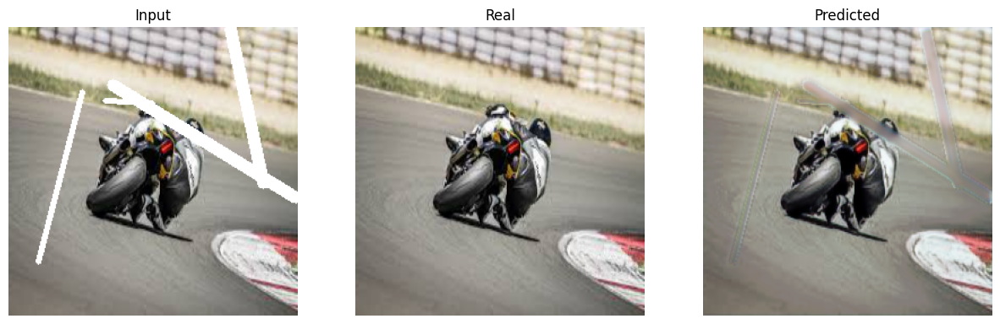

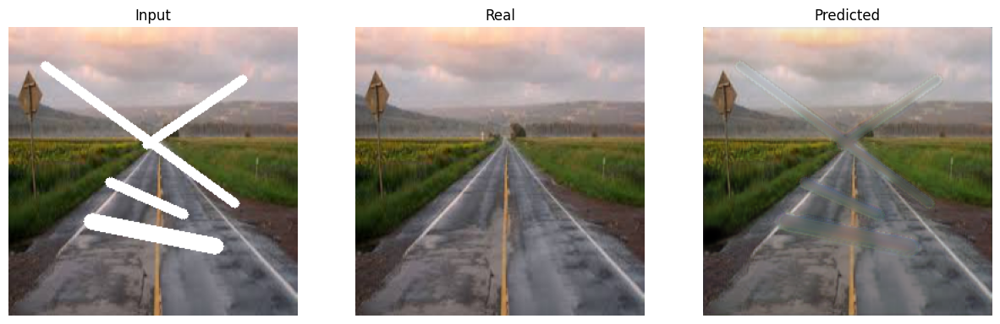

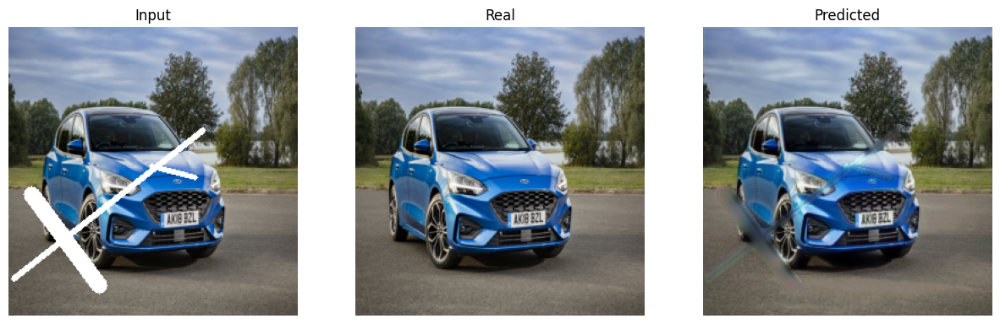

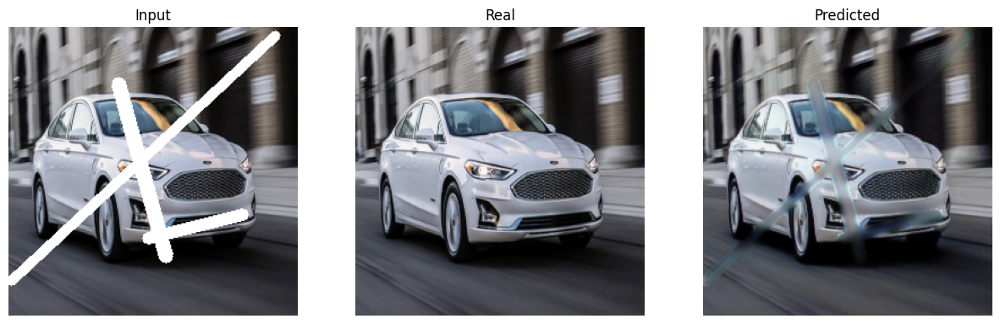

In [58]:
predict_and_display(model, train_loader, device)

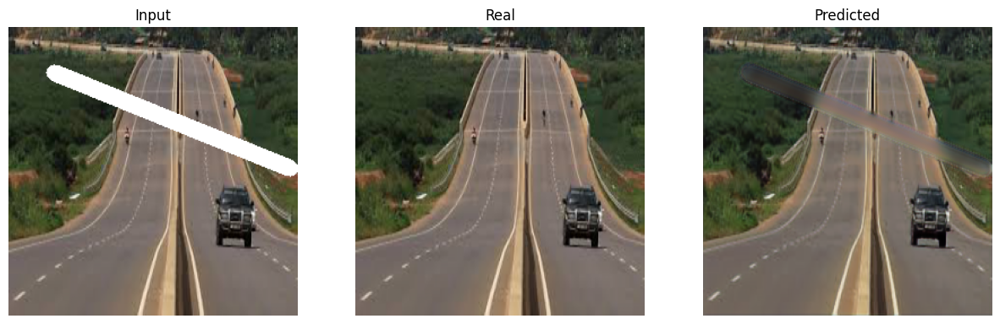

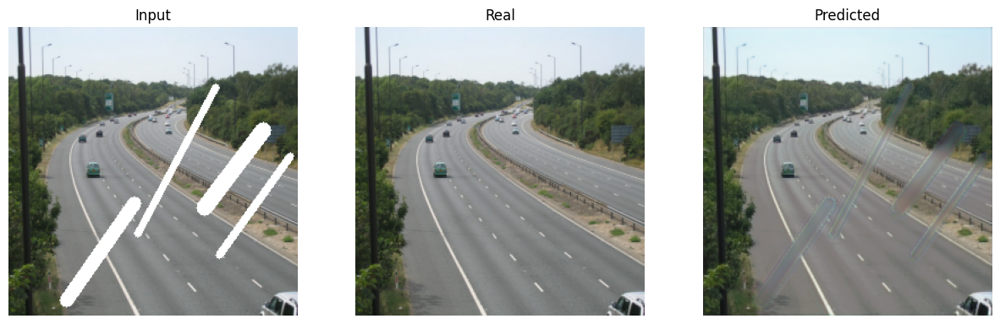

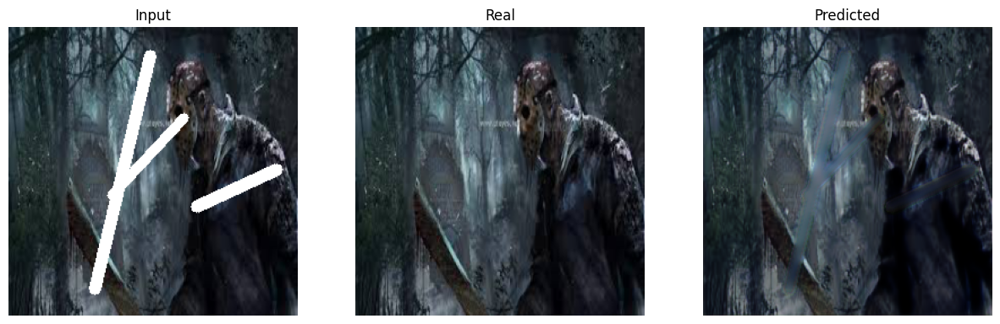

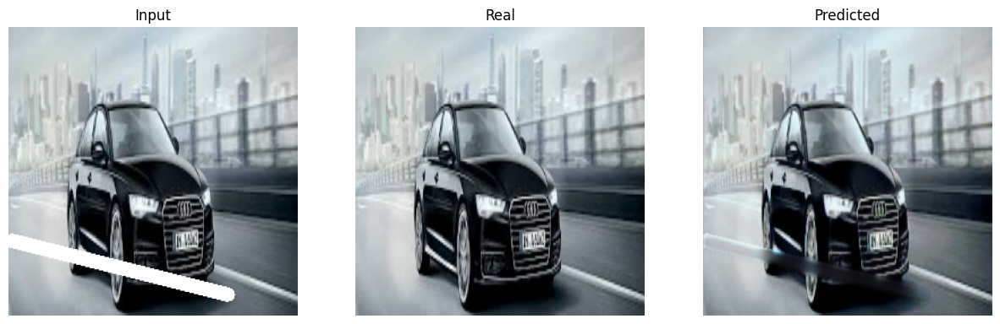

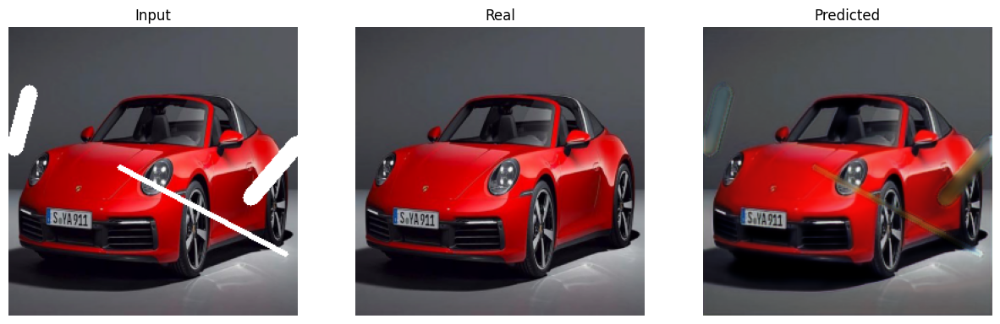

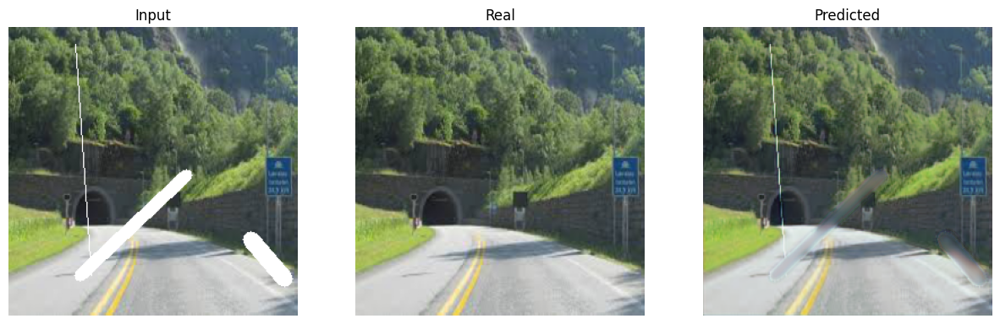

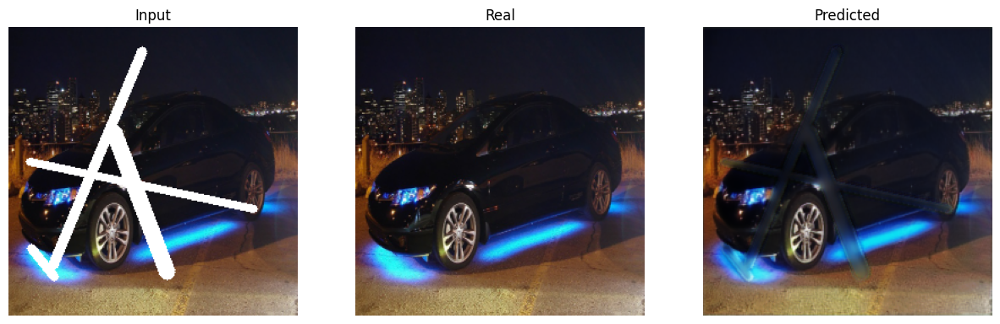

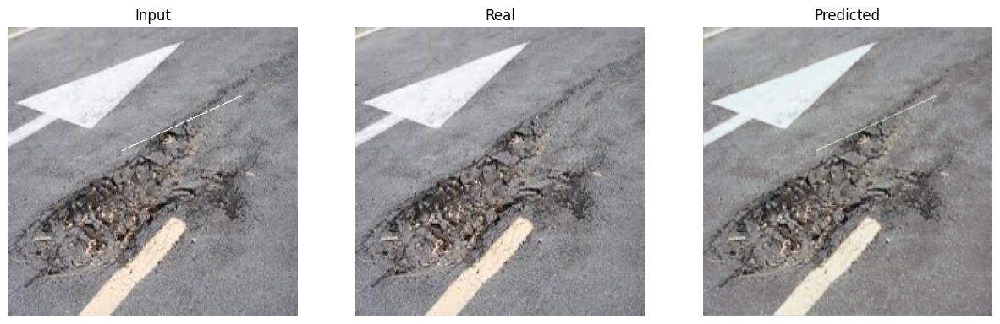

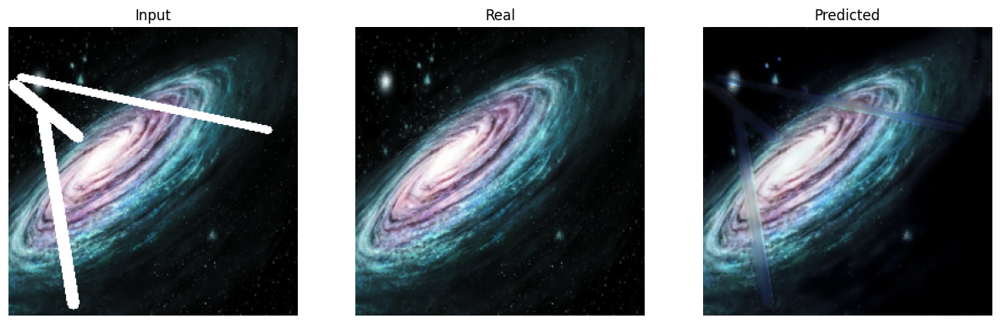

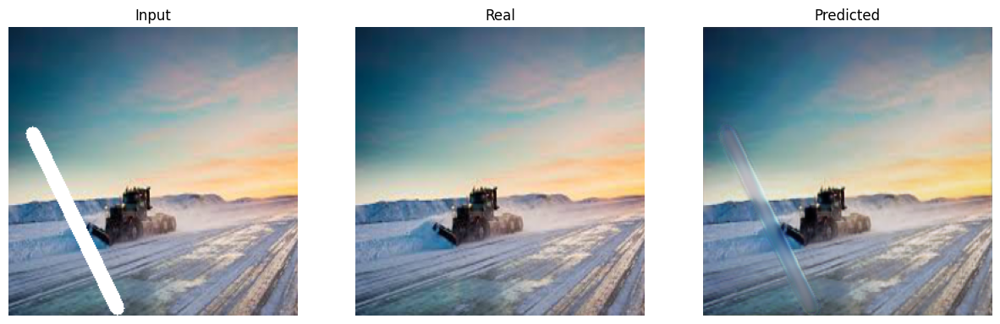

In [59]:
predict_and_display(model, test_loader, device)

In [60]:
class DecoderNoSkip(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Decoder, self).__init__()
        self.decode = nn.Sequential(
            nn.UpsamplingBilinear2d(scale_factor=2),
            nn.Conv2d(in_channels, out_channels * 2, 1, 1, 0, bias=False),
            nn.BatchNorm2d(out_channels * 2),
            nn.LeakyReLU(inplace=True)
        )
        self.conv = Conv_Block(in_channels, out_channels)

    def forward(self, x):
        x = self.decode(x)
        # x = torch.concat([x, skip], dim=1)
        x = self.conv(x)

        return x

class UnetNoSkip(nn.Module):
    def __init__(self, n_channels=3, n_classes=3):
        super(Unet, self).__init__()
        self.resize_func = transforms.Resize((low_height * 4, low_width * 4), antialias=True)

        self.conv_1 = First_Feature(n_channels, 64)
        self.conv_2 = Conv_Block(64, 64)

        self.encode_1 = Encoder(64, 128)
        self.encode_2 = Encoder(128, 256)
        self.encode_3 = Encoder(256, 512)
        self.encode_4 = Encoder(512, 1024)

        self.decode_1 = DecoderNoSkip(1024, 512)
        self.decode_2 = DecoderNoSkip(512, 256)
        self.decode_3 = DecoderNoSkip(256, 128)
        self.decode_4 = DecoderNoSkip(128, 64)

        self.out_conv = Final_Output(64, 3)

    def forward(self, x):
        x = self.resize_func(x)

        x = self.conv_1(x)
        x1 = self.conv_2(x)

        x2 = self.encode_1(x1)
        x3 = self.encode_2(x2)
        x4 = self.encode_3(x3)
        x5 = self.encode_4(x4)

        x = self.decode_1(x5, x4)
        x = self.decode_2(x, x3)
        x = self.decode_3(x, x2)
        x = self.decode_4(x, x1)

        x = self.out_conv(x)

        return x

| epoch   1 |    50/   86 batches | psnr   17.878


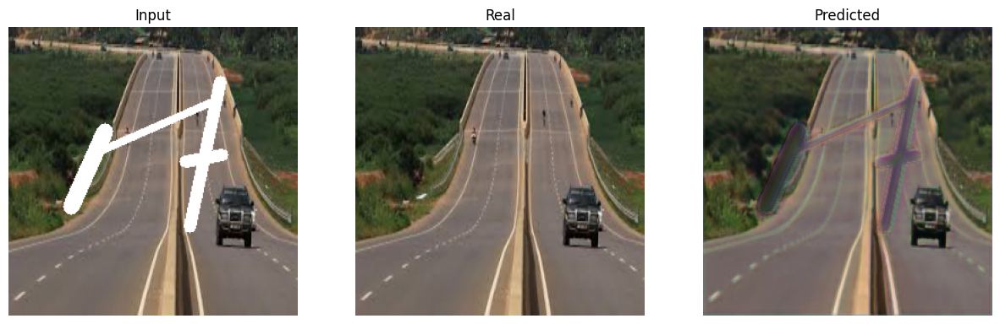

-----------------------------------------------------------
| End of epoch   1 | Time: 29.27s | Train psnr   21.108 | Train Loss    0.166 | Valid psnr   23.852 | Valid Loss    0.077 
-----------------------------------------------------------


<ipython-input-52-07fd8a1a5bbc>:34: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))


| epoch   2 |    50/   86 batches | psnr   22.009


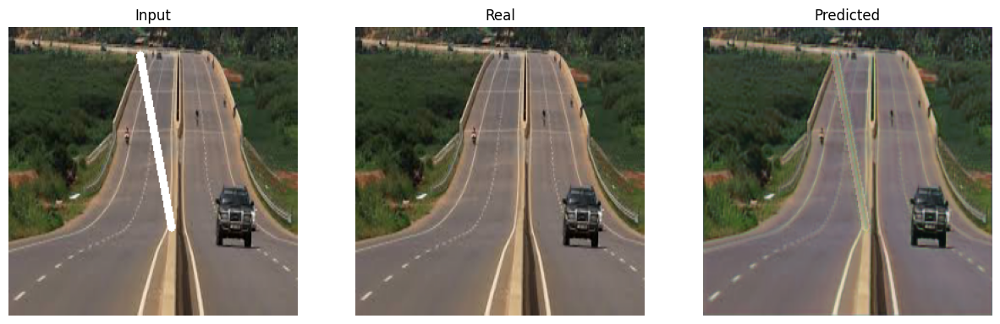

-----------------------------------------------------------
| End of epoch   2 | Time: 29.40s | Train psnr   22.904 | Train Loss    0.108 | Valid psnr   24.268 | Valid Loss    0.070 
-----------------------------------------------------------
| epoch   3 |    50/   86 batches | psnr   23.970


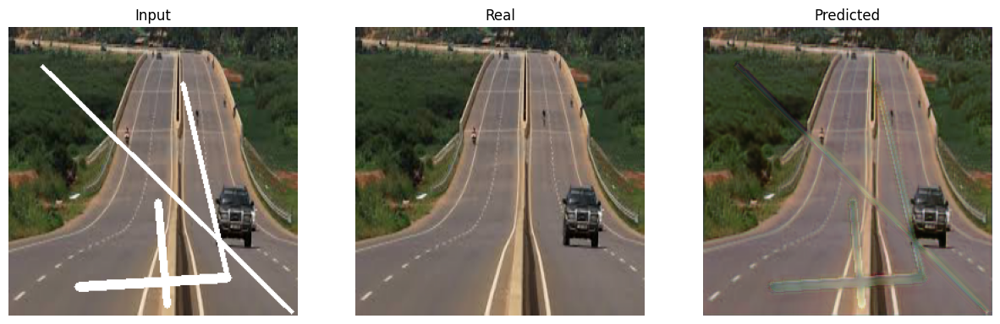

-----------------------------------------------------------
| End of epoch   3 | Time: 29.36s | Train psnr   24.220 | Train Loss    0.086 | Valid psnr   26.522 | Valid Loss    0.057 
-----------------------------------------------------------
| epoch   4 |    50/   86 batches | psnr   24.120


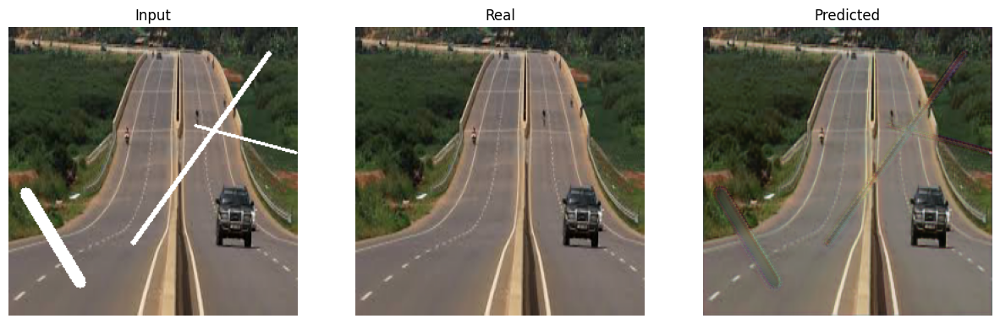

-----------------------------------------------------------
| End of epoch   4 | Time: 29.29s | Train psnr   24.710 | Train Loss    0.082 | Valid psnr   26.934 | Valid Loss    0.051 
-----------------------------------------------------------
| epoch   5 |    50/   86 batches | psnr   25.070
-----------------------------------------------------------
| End of epoch   5 | Time: 28.41s | Train psnr   24.567 | Train Loss    0.076 | Valid psnr   25.770 | Valid Loss    0.059 
-----------------------------------------------------------
| epoch   6 |    50/   86 batches | psnr   25.275


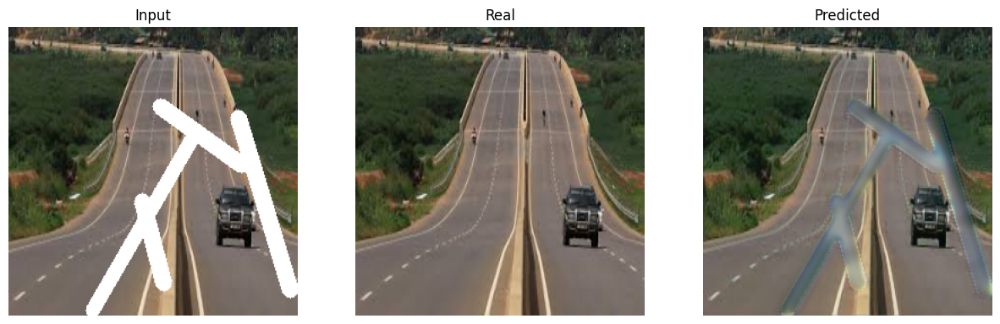

-----------------------------------------------------------
| End of epoch   6 | Time: 29.32s | Train psnr   25.462 | Train Loss    0.073 | Valid psnr   27.709 | Valid Loss    0.049 
-----------------------------------------------------------
| epoch   7 |    50/   86 batches | psnr   25.485
-----------------------------------------------------------
| End of epoch   7 | Time: 28.40s | Train psnr   25.675 | Train Loss    0.071 | Valid psnr   23.787 | Valid Loss    0.062 
-----------------------------------------------------------
| epoch   8 |    50/   86 batches | psnr   25.428
-----------------------------------------------------------
| End of epoch   8 | Time: 28.35s | Train psnr   25.008 | Train Loss    0.072 | Valid psnr   26.235 | Valid Loss    0.053 
-----------------------------------------------------------
| epoch   9 |    50/   86 batches | psnr   25.646
-----------------------------------------------------------
| End of epoch   9 | Time: 28.31s | Train psnr   25.530 | Tra

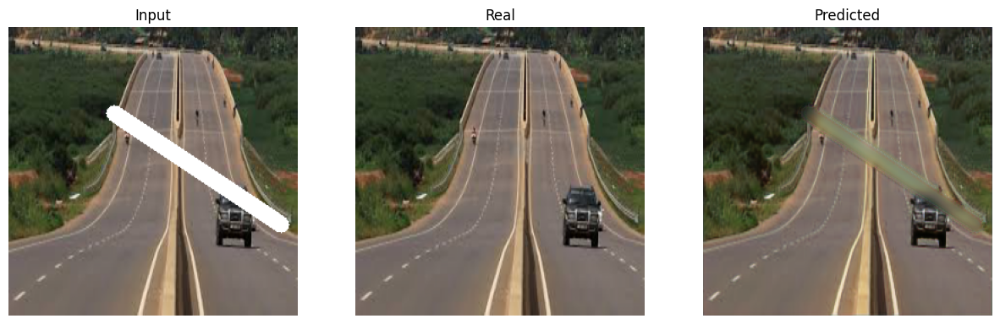

-----------------------------------------------------------
| End of epoch  30 | Time: 29.60s | Train psnr   25.767 | Train Loss    0.069 | Valid psnr   28.003 | Valid Loss    0.045 
-----------------------------------------------------------
| epoch  31 |    50/   86 batches | psnr   25.783
-----------------------------------------------------------
| End of epoch  31 | Time: 28.63s | Train psnr   25.817 | Train Loss    0.069 | Valid psnr   24.351 | Valid Loss    0.066 
-----------------------------------------------------------
| epoch  32 |    50/   86 batches | psnr   25.177
-----------------------------------------------------------
| End of epoch  32 | Time: 28.62s | Train psnr   25.731 | Train Loss    0.072 | Valid psnr   25.065 | Valid Loss    0.055 
-----------------------------------------------------------
| epoch  33 |    50/   86 batches | psnr   25.322
-----------------------------------------------------------
| End of epoch  33 | Time: 28.63s | Train psnr   24.867 | Tra

In [63]:
model_no_skip = Unet()
model_no_skip = model_no_skip.to(device)

criterion = nn.L1Loss()
optimizer = optim.Adam(model_no_skip.parameters(), lr=learning_rate, betas=[0.5,0.999])
epochs = 65

save_model = './UNET'
os.makedirs(save_model, exist_ok = True)

model, metrics = train(model_no_skip, 'UNET', save_model, optimizer, criterion, train_loader, test_loader, device, epochs)

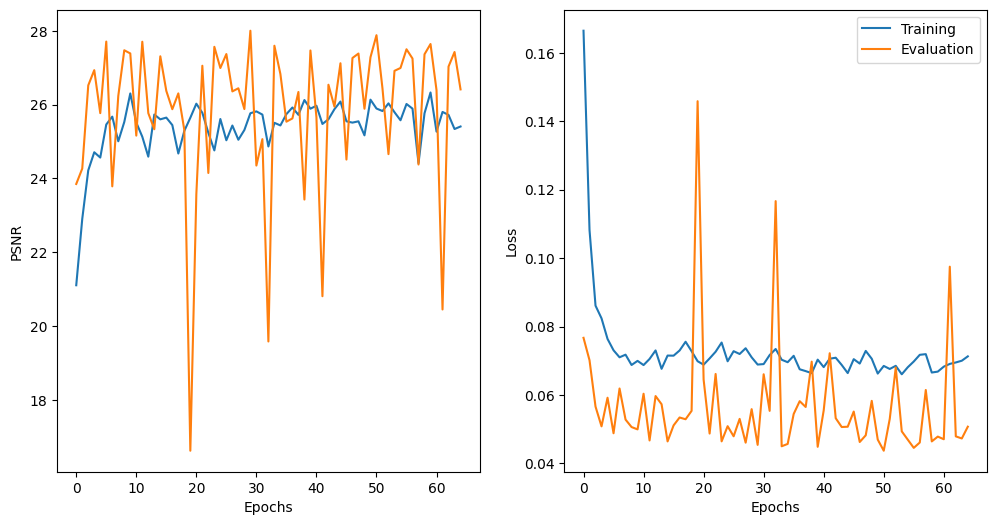

In [64]:
plot_result(
    epochs,
    metrics["train_psnr"],
    metrics["valid_psnr"],
    metrics["train_loss"],
    metrics["valid_loss"]
)

In [65]:
test_psnr, test_loss = evaluate(model_no_skip, criterion, test_loader, device)
test_psnr, test_loss

(0.046270730312575, tensor(27.7640, device='cuda:0'))

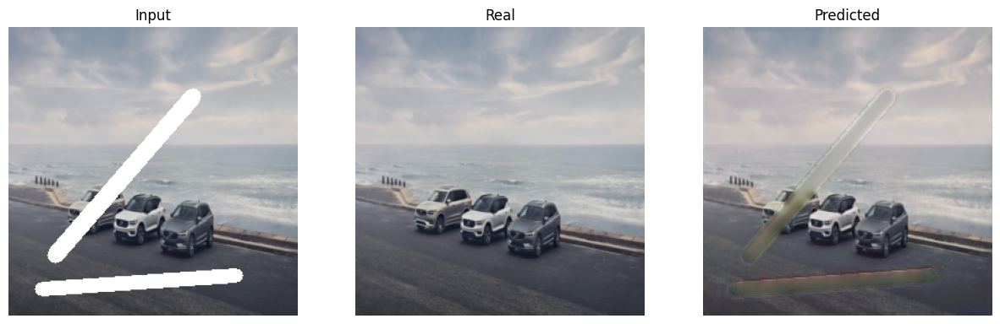

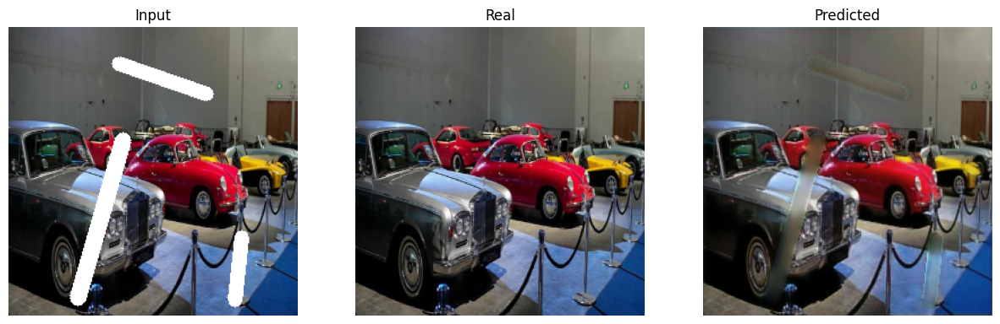

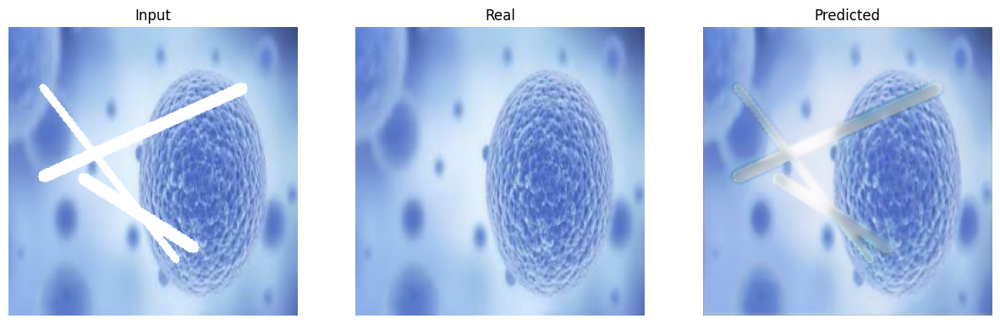

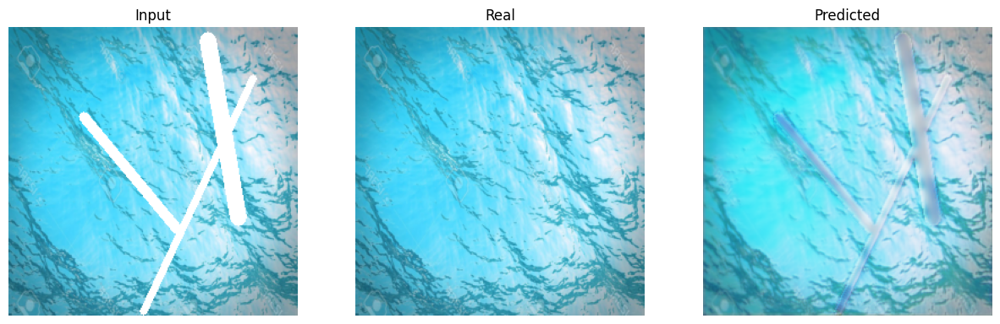

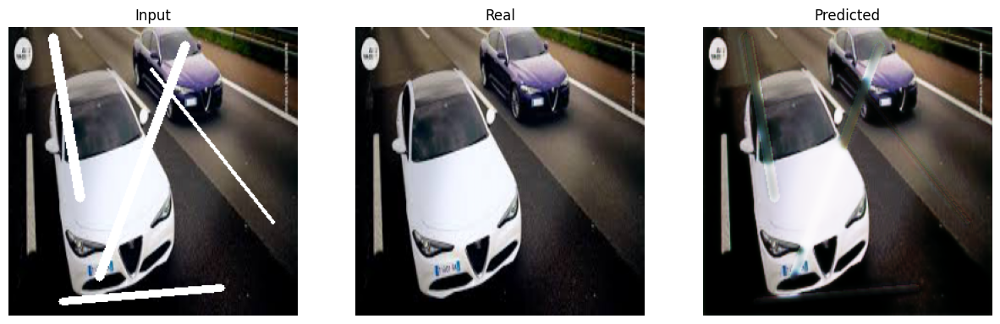

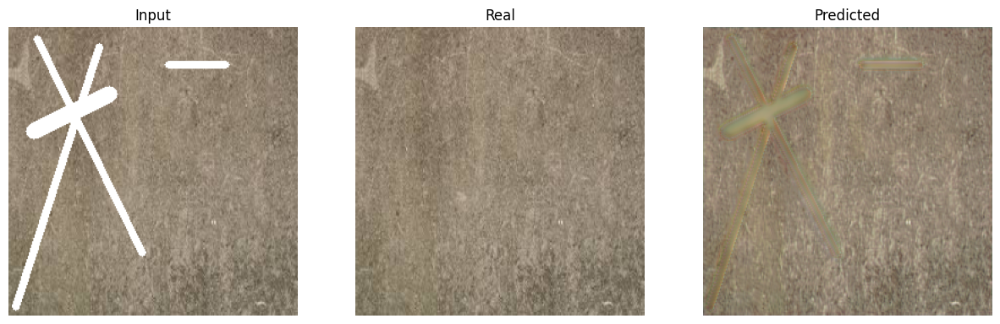

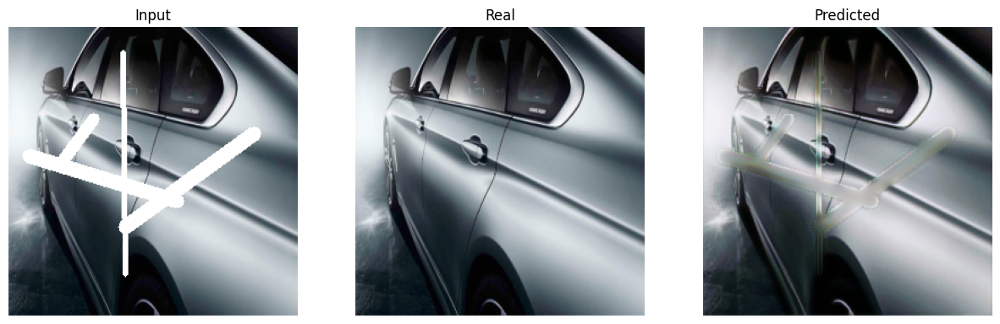

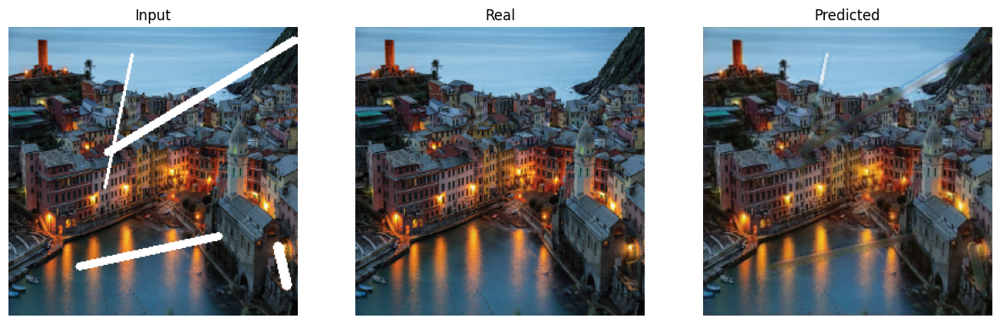

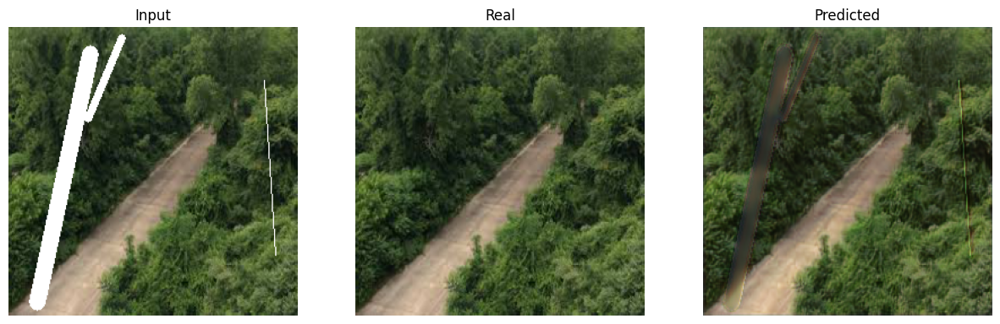

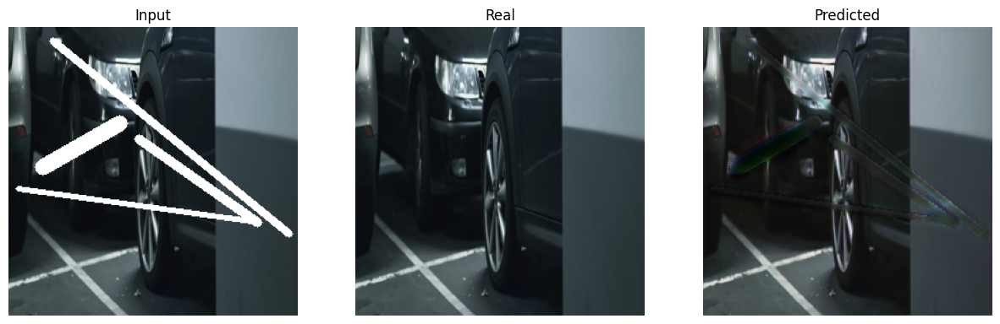

In [66]:
predict_and_display(model_no_skip, train_loader, device)

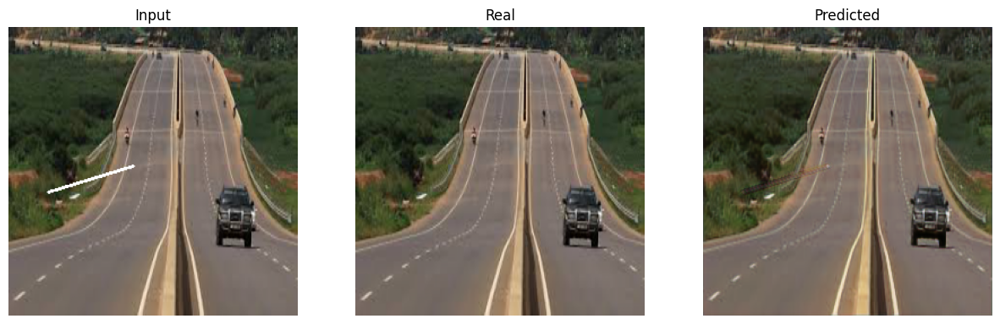

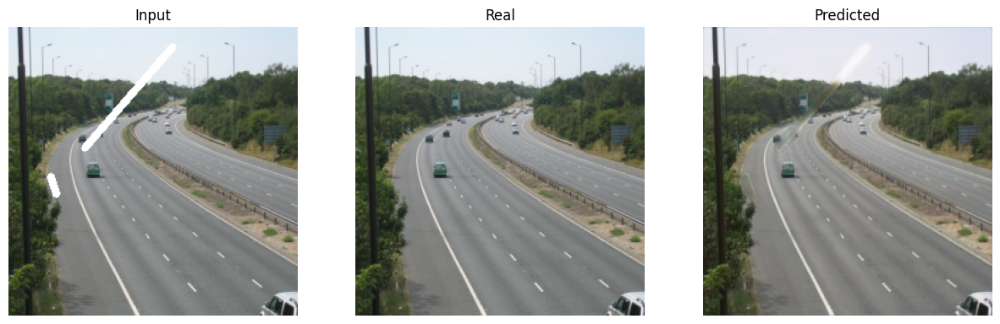

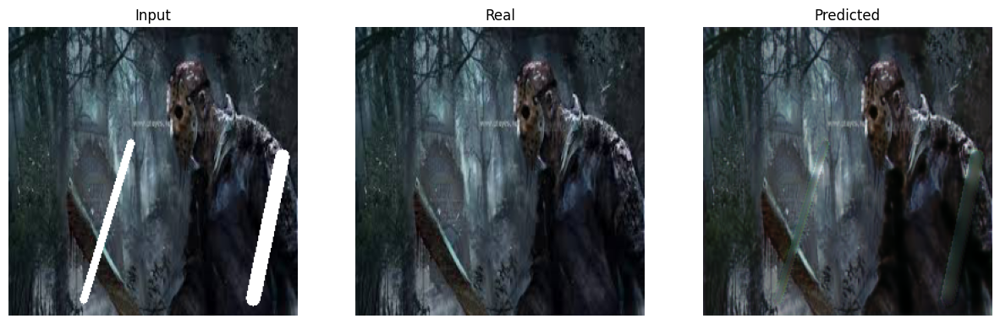

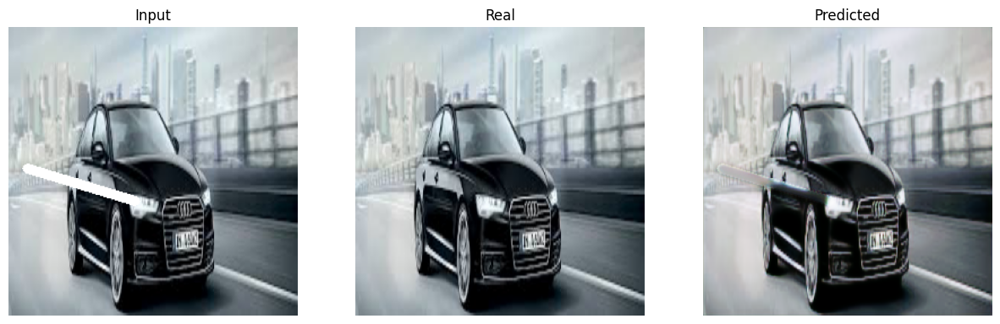

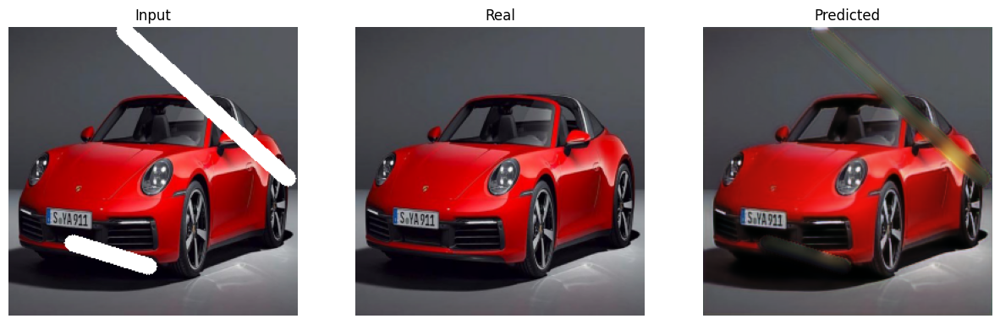

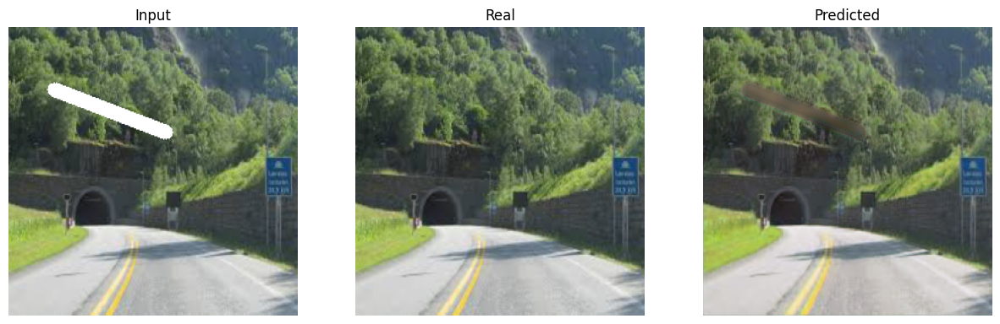

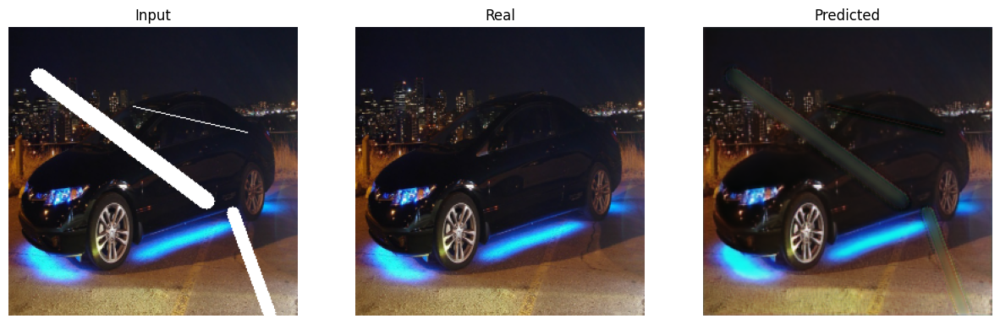

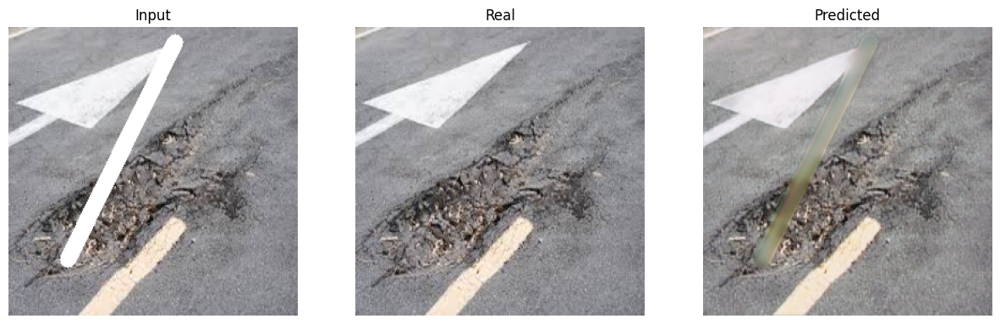

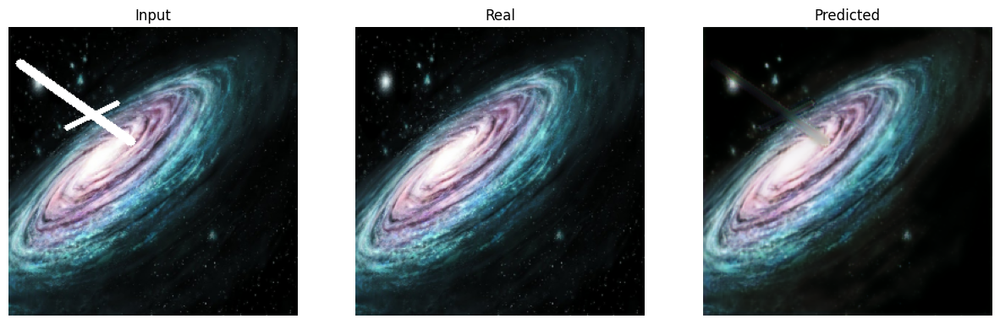

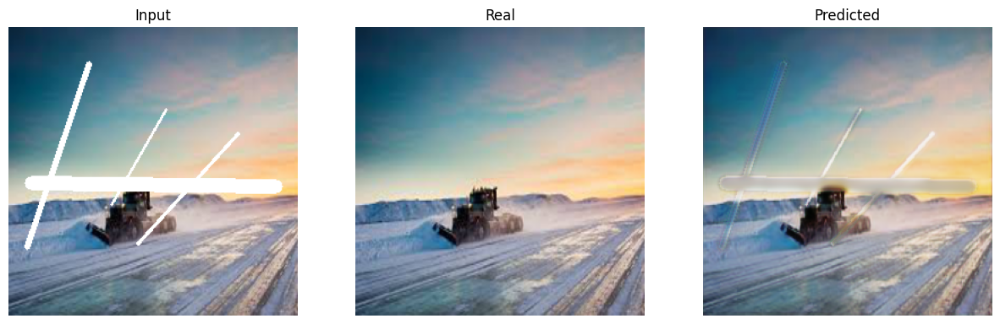

In [67]:
predict_and_display(model_no_skip, test_loader, device)